In [3]:
import json
import os
import glob
import cv2
import random
import torch

import numpy as np
from skimage import io
from IPython.display import clear_output
import matplotlib.pyplot as plt
from matplotlib import colors

In [4]:
def imshow(images, titles, ncols = 0, nrows = 0,figsize = (15, 20)):
  if ncols == 0 and nrows ==0:
    ncols = len(images)
    nrows = 1
  if ncols == 0:
    ncols = len(images) // nrows
  if nrows == 0:
    nrows = len(images) // ncols

  fig, axs = plt.subplots(nrows = nrows, ncols = ncols, squeeze = False, figsize = figsize)

  for i, image in enumerate(images):
    axs.ravel()[i].imshow(image, cmap = plt.gray(), vmin = 0, vmax = 255)
    axs.ravel()[i].set_title(titles[i])
    axs.ravel()[i].set_axis_off()
  plt.tight_layout()


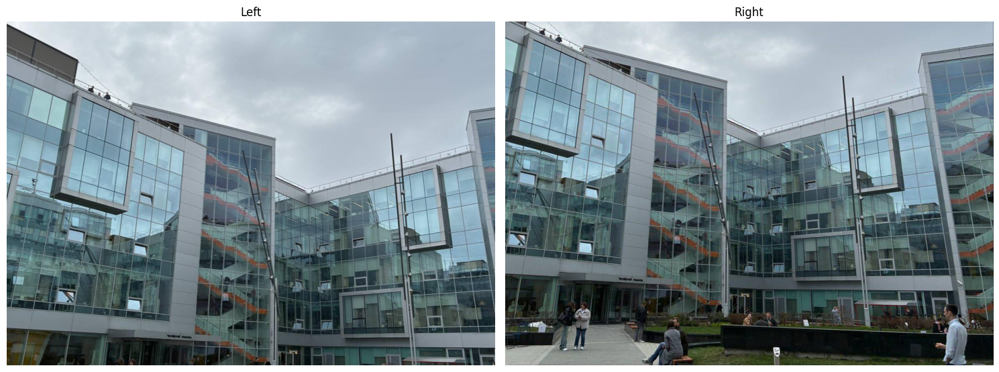

In [5]:
# do not change the code in the block below
# __________start of block__________
# Create a dictionary to store images with the same prefix
image_dict = {}

# Read all images and group them by prefix
for filename in sorted(glob.glob('./images/*.jpeg')):
    name = os.path.basename(filename)
    prefix = name.split('_')[0]  # Get prefix before first underscore
    
    # Load the image
    img = io.imread(filename)
    # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Add to dictionary
    if prefix in image_dict:
        image_dict[prefix].append((img))
    else:
        image_dict[prefix] = [(img)]
# __________end of block__________

# do not change the code in the block below
# __________start of block__________
image1, image2 = image_dict['example2']
imshow( [image1, image2], ['Left', 'Right'])
# __________end of block__________

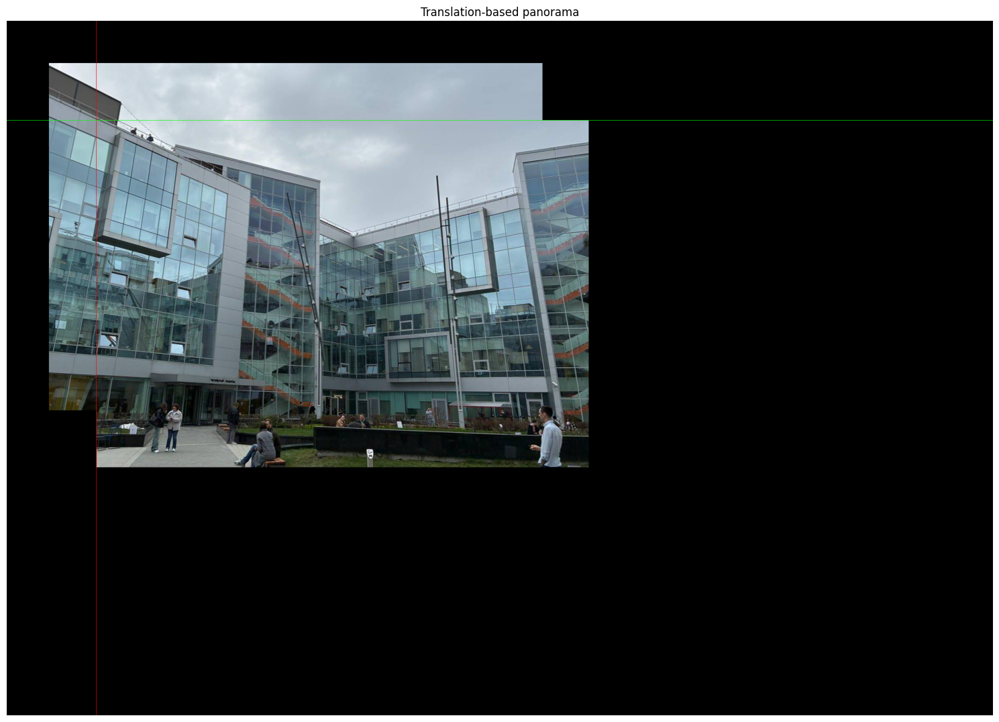

In [6]:
X_shift = 100
Y_shift = 100
tx = 112
ty = 135

assert tx + X_shift >= 0
assert ty + Y_shift >= 0

size = (image1.shape[0] + image2.shape[0], image1.shape[1] + image2.shape[1], 3)
image_trans = np.uint8(np.zeros(size))

image_trans[Y_shift: Y_shift + image1.shape[0], X_shift:X_shift + image1.shape[1], :] = image1
image_trans[Y_shift + ty:Y_shift + ty + image2.shape[0], X_shift + tx:X_shift + tx + image2.shape[1], :] = image2

image_trans[:, X_shift + tx, :] = [255, 0, 0]
image_trans[Y_shift + ty, :, :] = [0, 255, 0]

imshow([image_trans], ['Translation-based panorama'])

In [7]:
def extract_key_points(img1, img2):
  sift = cv2.SIFT_create()

  if len(img1.shape) == 3:
    img1_gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
  else:
    img1_gray = img1

  if len(img2.shape) == 3:
    img2_gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
  else:
    img2_gray = img2

  kpts1, desc1 = sift.detectAndCompute(img1_gray, None)
  kpts2, desc2 = sift.detectAndCompute(img2_gray, None)

  return kpts1, desc1, kpts2, desc2

kp1, des1, kp2, des2 = extract_key_points(image1, image2)
print("Coordinates of the first keypoint of image1: ", kp1[0].pt)
print("Descriptor of the first keypoint of image1:\n", des1[0])

Coordinates of the first keypoint of image1:  (3.0671353340148926, 807.9583129882812)
Descriptor of the first keypoint of image1:
 [ 11.  23.   7.   0.   0.   2.   1.  15.  17.  20.  21.   2.   0.  12.
  47.  59.   0.   8.  44.   4.   0.  33. 124.  11.   1.   7.  23.   6.
   4.  31.  39.   2.  52.   4.   0.   0.   1.   5.   2.  32. 137.  27.
   5.   6.   3.  22.  88. 137.  19.   8.  18.  63.  34. 122. 137.  41.
   0.   1.  13.  38.  93. 120.  67.   1.  43.  15.   2.   2.   3.   2.
   1.   2. 137. 137.  68.  32.   2.   2.   3.  14.  15.  39. 137. 137.
  22.  12.   5.   4.   0.   0.  89. 116.  42.   6.   0.   0.   2.   1.
   0.   0.   0.   0.   0.   0.   6.  15.  10.   4.   0.   0.   0.   0.
   0.   3.  22.  30.   0.   0.   0.   0.   0.   0.  14.  12.   0.   0.
   0.   0.]


In [8]:
with open('keypoints_sift.json', 'r') as f:
    loaded_data = json.load(f)

for kp, loaded_kp in zip(kp1[:10], loaded_data['keypoints1']):
    assert np.allclose(kp.pt, loaded_kp, atol=1e-5), f"keypoint {kp.pt} and {loaded_kp} are not close"

2339


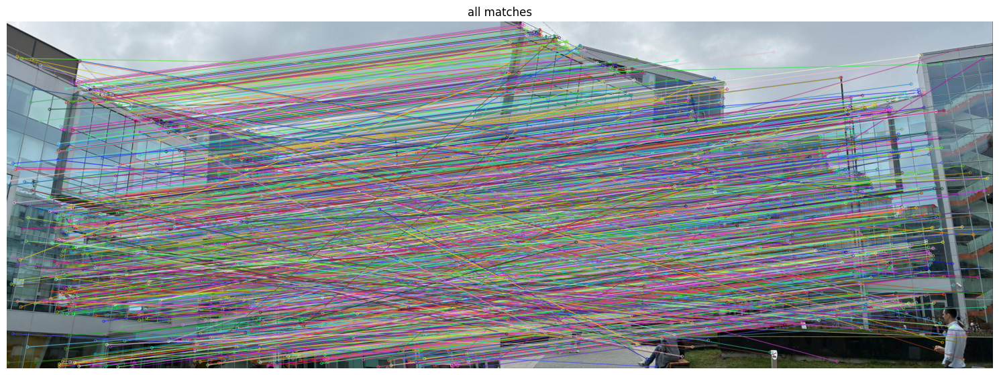

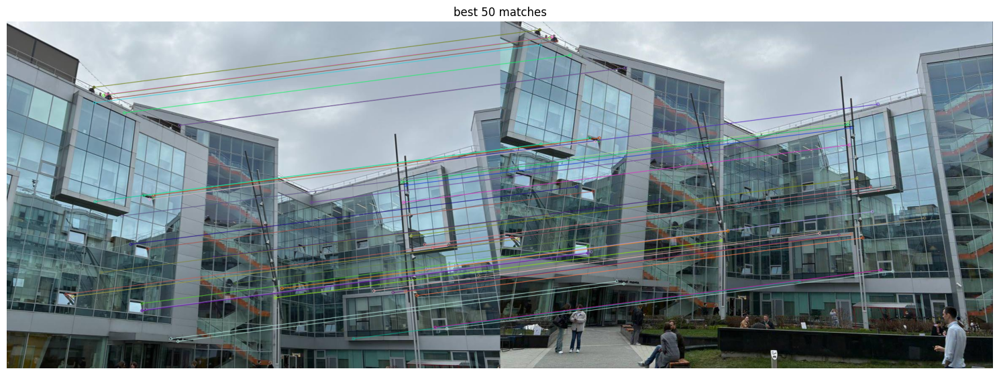

In [9]:
def match_key_points_cv(desc1, desc2):
  bf = cv2.BFMatcher(crossCheck = True)
  matches = bf.match(desc1, desc2)

  sorted_matches = sorted(matches, key = lambda x:x.distance)
  return sorted_matches

def showMatches(img1, kp1, img2, kp2, matches, name):
    img = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    imshow([img],[name])

matches_cv = match_key_points_cv(des1, des2)

print(len(matches_cv))
showMatches(image1,kp1,image2,kp2,matches_cv,"all matches")
showMatches(image1,kp1,image2,kp2,matches_cv[:50],"best 50 matches")

In [10]:
class DummyMatch:
  def __init__(self, queryIdx, trainIdx, distance):
    self.queryIdx = queryIdx
    self.trainIdx = trainIdx
    self.distance = distance

def match_key_points_numpy(desc1, desc2):
    dist = np.linalg.norm(desc1[:, np.newaxis] - desc2[np.newaxis, :], axis = 2)
    nearest_desc2 = np.argmin(dist, axis = 1)
    nearest_desc1 = np.argmin(dist, axis = 0)
    matches = []
    for i, j in enumerate(nearest_desc2):
        if nearest_desc1[j] == i:
            match = DummyMatch(queryIdx=i, trainIdx=j, distance=dist[i, j])
            matches.append(match)
    matches.sort(key=lambda m: m.distance)
    return matches

In [11]:
def test_numpy_bf_matcher_equivalence(des1, des2):
    # OpenCV BFMatcher
    cv_matches = match_key_points_cv(des1, des2)

    # Our matcher
    np_matches = match_key_points_numpy(des1, des2)

    # Compare match indices and distances
    assert len(cv_matches) == len(np_matches), f"Match count mismatch: {len(cv_matches)} vs {len(np_matches)}"

    for idx, (m_cv, m_np) in enumerate(zip(cv_matches, np_matches)):
        assert m_cv.queryIdx == m_np.queryIdx
        assert m_cv.trainIdx == m_np.trainIdx
        assert abs(m_cv.distance - m_np.distance) < 1e-4, f"Distance mismatch on {idx}th match: {m_cv.distance:.4f} vs {m_np.distance:.4f}"

    print("Your numpy implementation matches OpenCV BFMatcher output!")

test_numpy_bf_matcher_equivalence(des1, des2)
# __________end of block__________

Your numpy implementation matches OpenCV BFMatcher output!


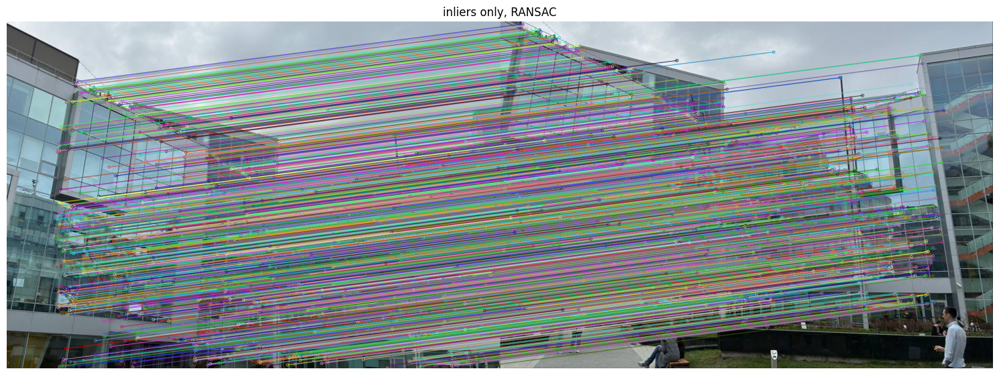

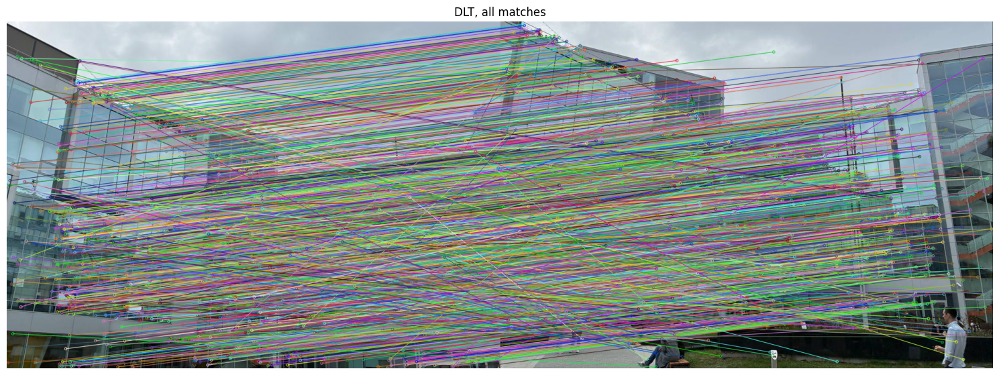

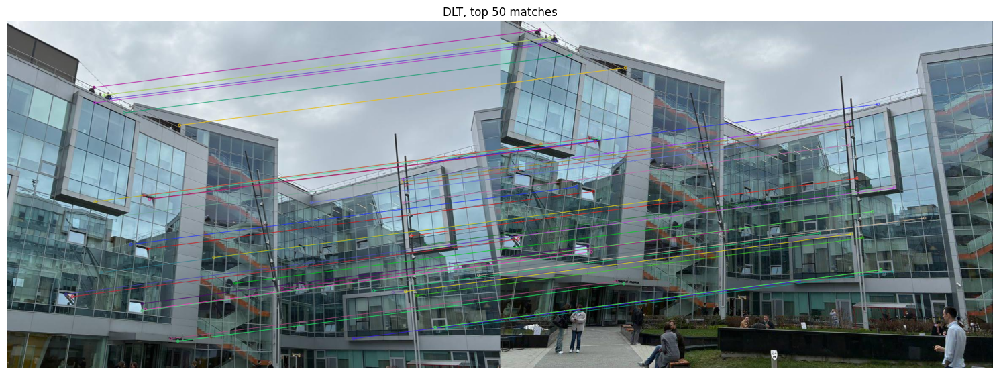

In [12]:
def findHomography_dlt_opencv(matches, keypoint1, keypoint2, mode='DLT'):

    src_pts = np.float32([keypoint1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
    dst_pts = np.float32([keypoint2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)

    if mode == 'DLT':
        mode = 0
    elif mode == 'RANSAC':
        mode = cv2.RANSAC
    H, mask = cv2.findHomography(src_pts, dst_pts, mode)
    mask = mask.ravel().tolist()

    inliers = []
    for i in range(len(mask)):
      if mask[i] == 1:
        inliers.append(matches[i])

    return H, inliers


H_for_panorama, inliers = findHomography_dlt_opencv(matches_cv, kp1, kp2, 'RANSAC')
showMatches(image1,kp1,image2,kp2,inliers,"inliers only, RANSAC")


H, inliers = findHomography_dlt_opencv(matches_cv, kp1, kp2, 'DLT')
showMatches(image1,kp1,image2,kp2,inliers,"DLT, all matches")

H, inliers = findHomography_dlt_opencv(matches_cv[:50], kp1, kp2, 'DLT')
showMatches(image1,kp1,image2,kp2,inliers,"DLT, top 50 matches")

In [13]:
def normalize_points(pts):
    pts = pts.reshape(-1, 2)

    mean = np.mean(pts, axis = 0)
    std = np.std(pts, axis = 0).mean()

    scale = np.sqrt(2) / std

    T = np.array([
        [scale,     0, -scale * mean[0]],
        [    0, scale, -scale * mean[1]],
        [    0,     0,               1]
    ])

    pts_h = np.hstack([pts, np.ones((pts.shape[0], 1))])

    pts_norm = (T @ pts_h.T).T

    return pts_norm, T

In [14]:
def dlt_homography_normalized(pts1: np.ndarray, pts2: np.ndarray) -> np.ndarray:
    pts1 = pts1.reshape(-1, 2)
    pts2 = pts2.reshape(-1, 2)

    pts1_norm, T1 = normalize_points(pts1)
    pts2_norm, T2 = normalize_points(pts2)

    N = pts1.shape[0]
    A = []

    for i in range(N):
        x, y = pts1_norm[i, 0], pts1_norm[i, 1]
        x_, y_ = pts2_norm[i, 0], pts2_norm[i, 1]
        A.append([-x, -y, -1,  0,  0,  0, x * x_, y * x_, x_])
        A.append([ 0,  0,  0, -x, -y, -1, x * y_, y * y_, y_])

    A = np.array(A)

    _, _, Vt = np.linalg.svd(A)
    H_norm = Vt[-1].reshape(3, 3)

    H = np.linalg.inv(T2) @ H_norm @ T1
    H = H / H[2, 2]

    return H

In [15]:
def findHomography_dlt_numpy(matches, keypoint1, keypoint2):
    src_pts = np.float32([keypoint1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
    dst_pts = np.float32([keypoint2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)
    return dlt_homography_normalized(src_pts, dst_pts), None

In [16]:
# do not change the code in the block below
# __________start of block__________
NUM_BEST_MATCHES = 50

kp1, des1, kp2, des2 = extract_key_points(*image_dict['example2'])
matches_cv = match_key_points_cv(des1, des2)

H_numpy, _ = findHomography_dlt_numpy(matches_cv[:NUM_BEST_MATCHES], kp1, kp2)
H, _ = findHomography_dlt_opencv(matches_cv[:NUM_BEST_MATCHES], kp1, kp2, mode='DLT')
assert np.allclose(H_numpy, H, atol=2e-1), f"Homography matrices are too different!\nH_numpy:\n{H_numpy}\nH from opencv:\n{H}"
# __________end of block__________

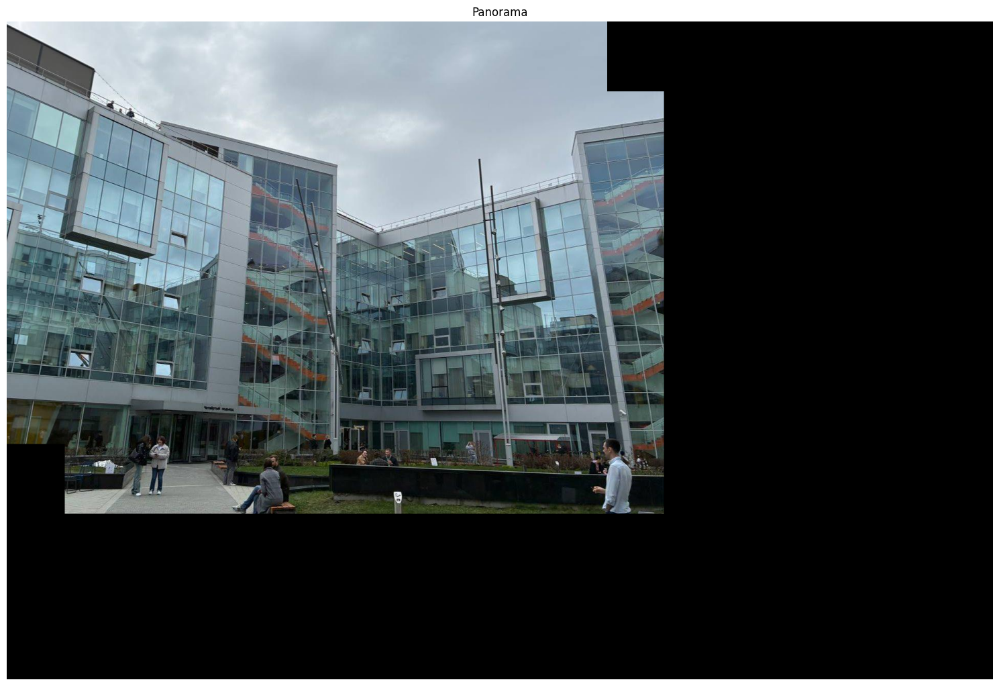

In [17]:
def panorama(img1, img2, H, size):
    img = np.uint8(np.zeros(size))
    img = cv2.warpPerspective(src=img1, dst=img, M=np.eye(3), dsize=(size[1], size[0]))
    img = cv2.warpPerspective(src=img2, dst=img, M=H, dsize=(size[1], size[0]), flags=cv2.WARP_INVERSE_MAP, borderMode=cv2.BORDER_TRANSPARENT)

    return img

size = (1280, 960*2, 3)
imshow([panorama(image1, image2, H_for_panorama, size)],["Panorama"])

In [ ]:
def panorama_pipeline(img1, img2, size):
    kp1, des1, kp2, des2 = extract_key_points(img1, img2)
    
    # 1. Получаем все сопоставления
    matches = match_key_points_cv(des1, des2)

    # 2. Оставляем только 50 лучших
    best_matches = matches[:50]

    # 3. Находим гомографию только по ним
    H, _ = findHomography_dlt_opencv(matches_cv[:NUM_BEST_MATCHES], kp1, kp2, mode='RANSAC')

    # 4. Проверяем размер (ширина, высота)
    if len(size) == 3:
        size = (size[0], size[1])

    # 5. Собираем панораму
    result = panorama(img1, img2, H, size)

    return result, H

In [18]:
def panorama_pipeline(img1, img2, size):
    kp1, des1, kp2, des2 = extract_key_points(img1, img2)
    matches_cv = match_key_points_cv(des1, des2)
    H, _ = findHomography_dlt_opencv(matches_cv[:NUM_BEST_MATCHES], kp1, kp2, 'RANSAC')
    
    height, width, channels = size
    res = np.zeros((height, width, channels), dtype=img1.dtype)

    res = cv2.warpPerspective(src=img1,
                M=np.eye(3),
                dsize=(width, height),
                dst=res
    )
    
    res = cv2.warpPerspective(src=img2,
                M=H,
                dsize=(width, height),
                dst=res,
                flags=cv2.WARP_INVERSE_MAP | cv2.INTER_LINEAR,
                borderMode=cv2.BORDER_TRANSPARENT)

    return res, H

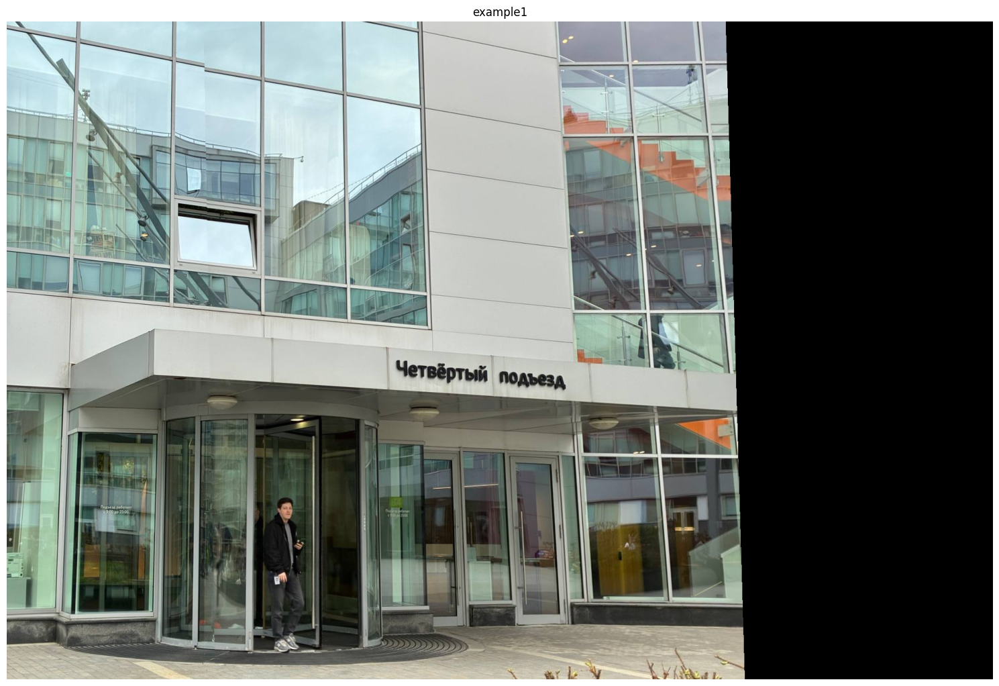

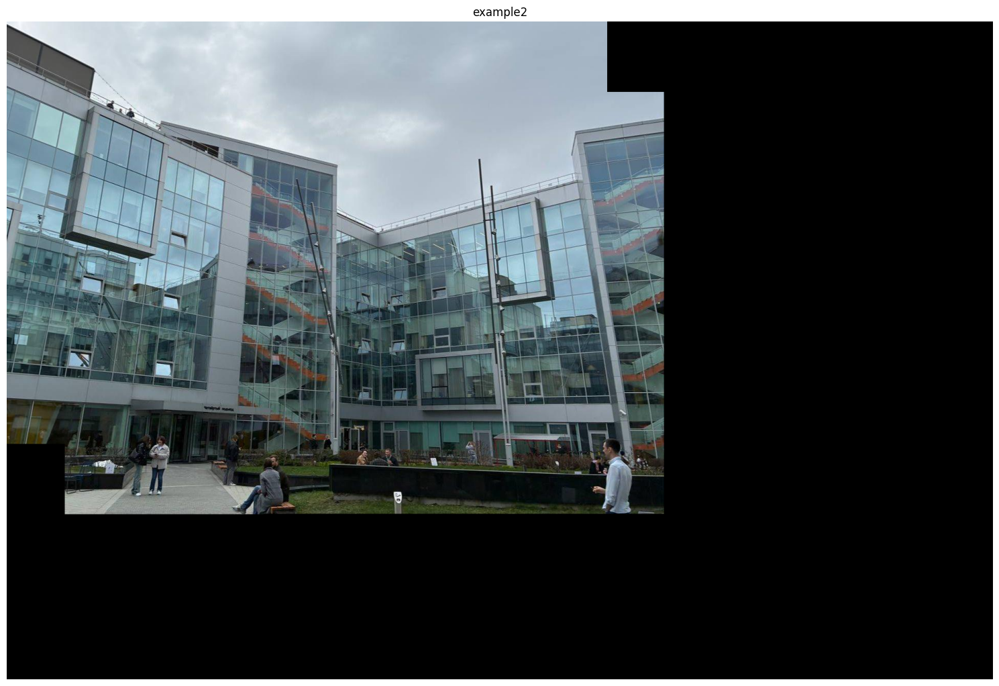

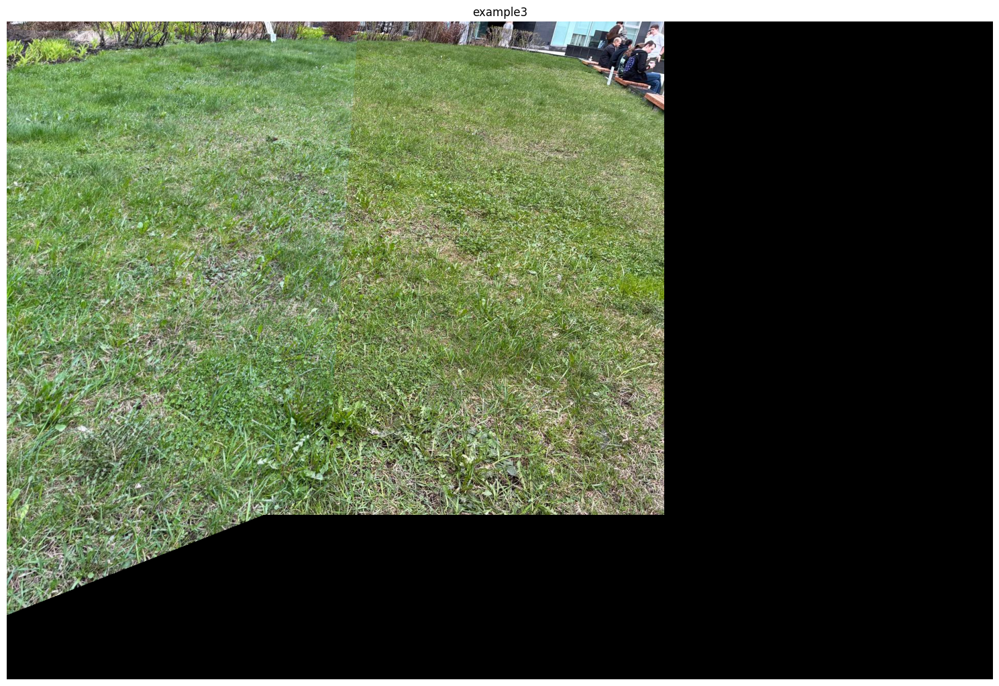

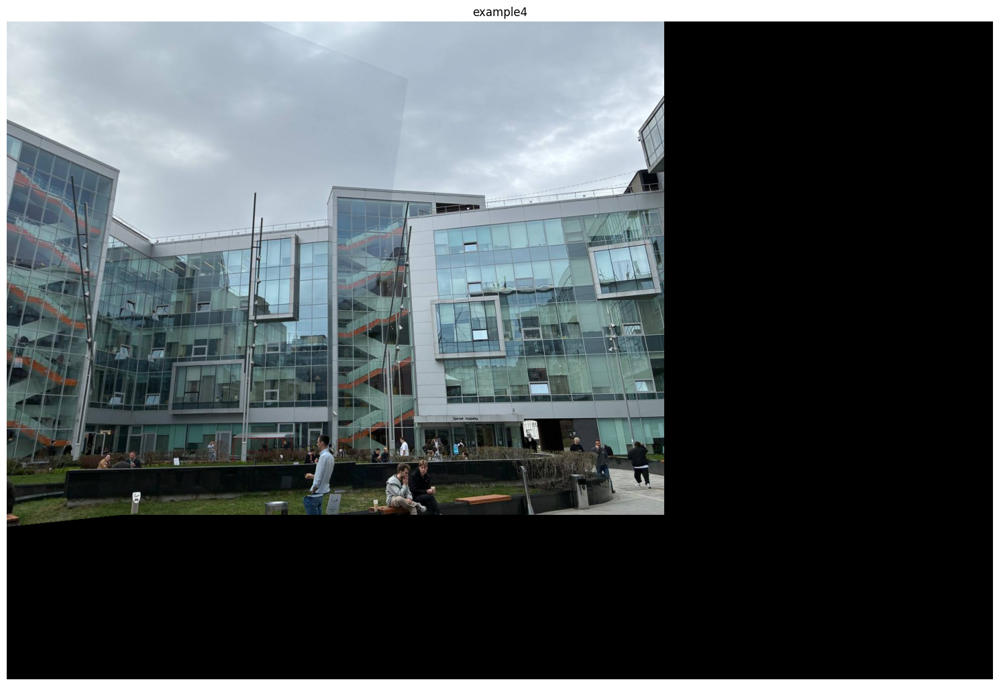

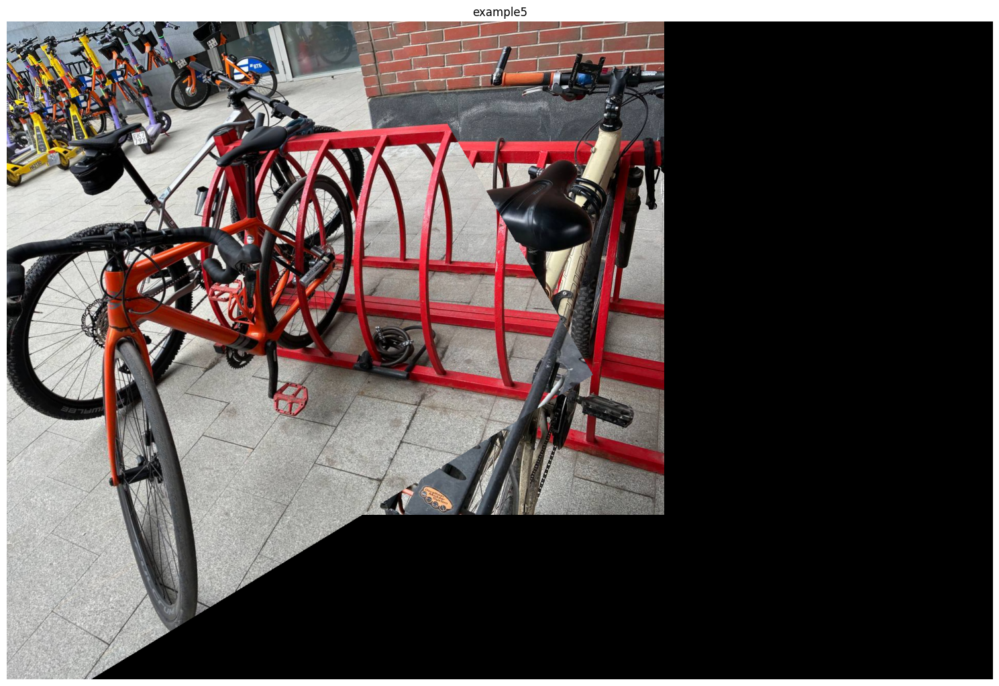

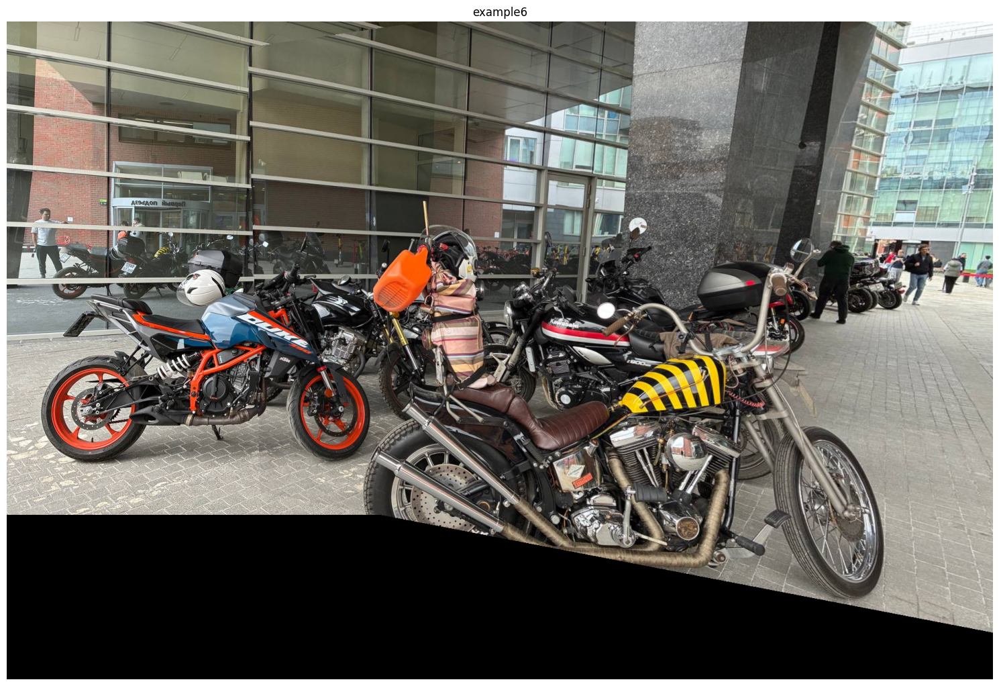

In [19]:
size = (1280, 960*2, 3)
h_dict = {}

for filename, (img1, img2) in image_dict.items():
    final_image, H = panorama_pipeline(img1, img2, size)
    h_dict[filename] = H.tolist()
    imshow([final_image],[filename])

with open('h_submission_dict.json', 'w') as iofile:
    json.dump(h_dict, iofile)

In [24]:
your_telegram_login = 'https://t.me/Dmittreb'

# do not change the code in the block below
# __________start of block__________
assert your_telegram_login[:13] == 'https://t.me/'
assert '@' not in your_telegram_login

with open('telegram_login.json', 'w') as iofile:
    json.dump([your_telegram_login], iofile)
# __________end of block__________